In [5]:
try
    using Gmsh: gmsh
catch
    using gmsh
end

using LinearAlgebra 
using SparseArrays 
using StaticArrays
using StaticRanges

using BenchmarkTools

using Test 

using Plots
using GR 
using SymPy
using FastGaussQuadrature
using WriteVTK 

## Assignment 1

### Coarse Mesh

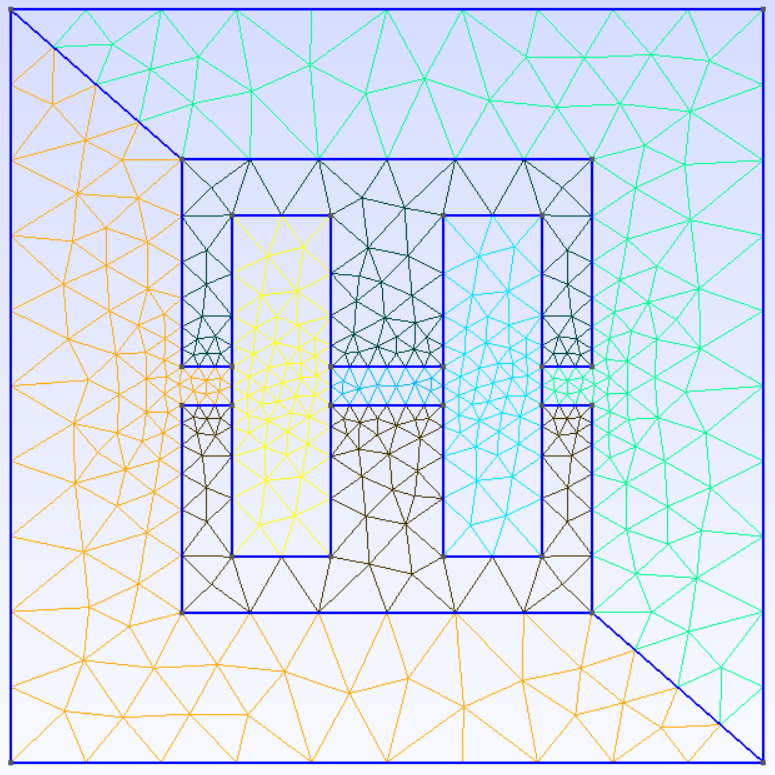

### Intermediate Mesh

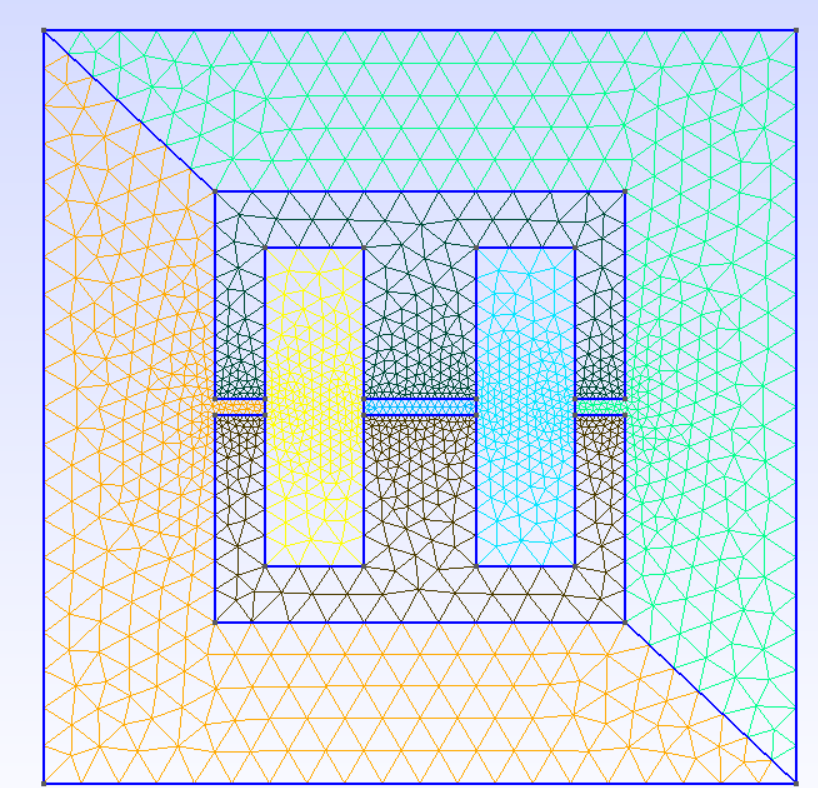

### Fine Mesh

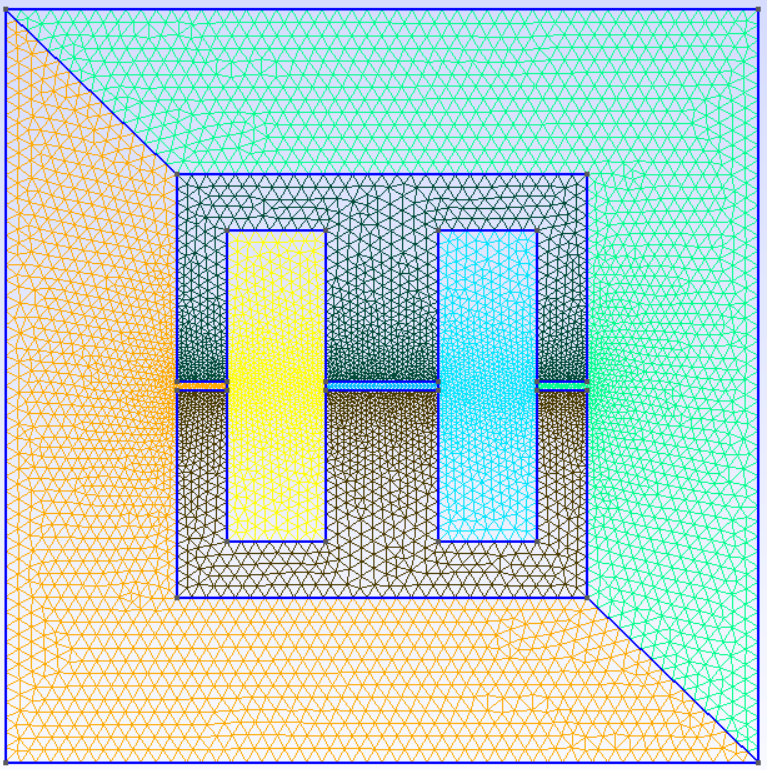

Finer the mesh the computation time will be larger as the number of elements(mesh triangles) will increase. Coarse will take the least time, intermediate mesh will take moderate time and fine mesh will take the most time to compute.

## Assignment 2

Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
  0.000447 seconds (21 allocations: 652.859 KiB)
  0.008428 seconds (1.21 k allocations: 1.714 MiB, 69.03% compilation time)


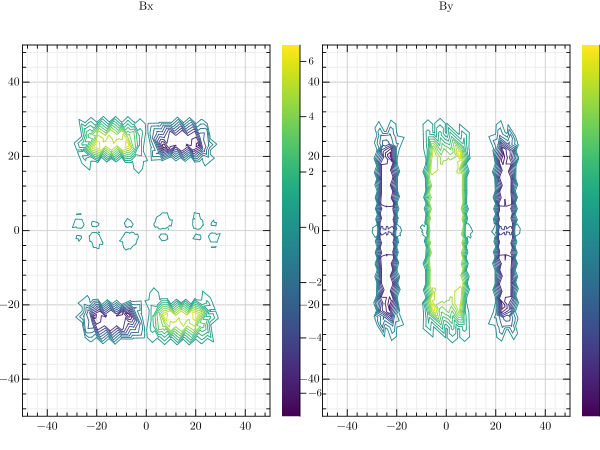

In [23]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor-coarse.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor-coarse.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-coarse.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")




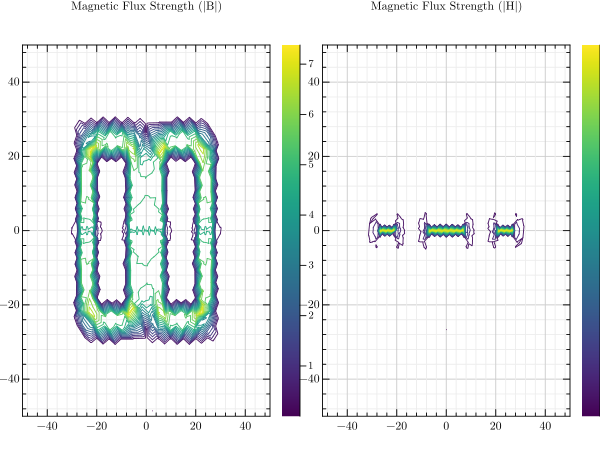

In [24]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic Flux Strength (|B|)")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="Magnetic Flux Strength (|H|)")

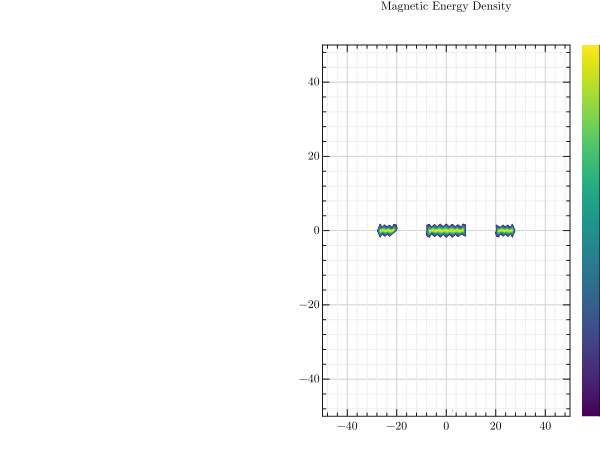

In [25]:
p4 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy Density")

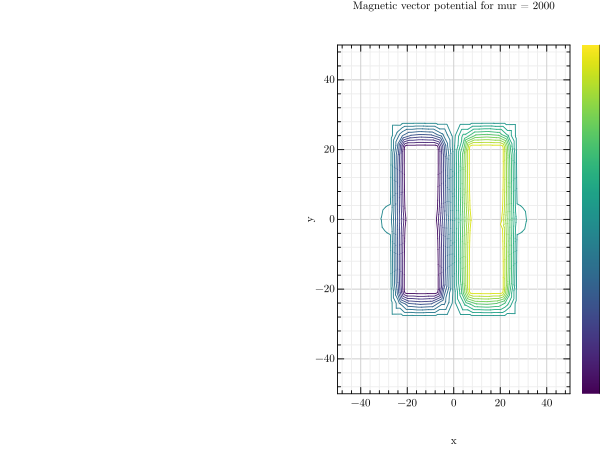

In [26]:
tricont(xnode,ynode,u,xlabel = "x", ylabel = "y",title = "Magnetic vector potential for mur = 2000")

Observation:
1) The magnetic flux density is concentrated is the edges and we can also observe some fringing effects.
2) The magnetic field strent]gth is concentrated in the air gap
3) The magnetic energy is also concentrated in the air gap which makes sense due to its high reluctivity.

## Assignment 3


In [18]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
# Update the reluctivityfunction to account for new μr values
mu0 = 4π * 1e-7  # Permeability of free space in Henries per meter (H/m)
mur = 50

reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end






function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end



genSolution! (generic function with 1 method)

Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
  0.007224 seconds (24 allocations: 11.586 MiB)
  0.087352 seconds (1.22 k allocations: 31.805 MiB, 2.94% gc time, 5.86% compilation time)


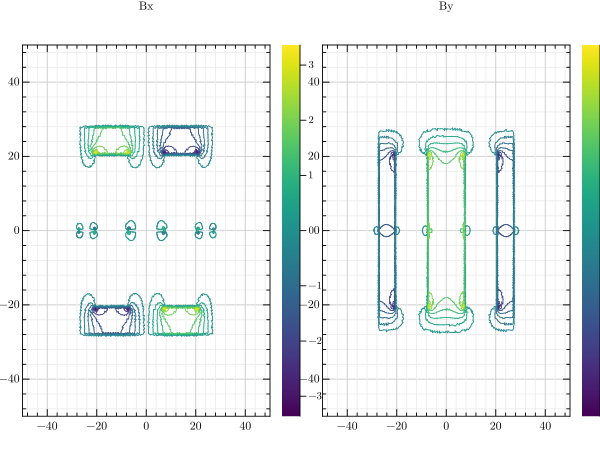

In [19]:
mesh = meshFromGmsh("data/inductor.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor.msh");  
xnode,ynode = nodesFromGmsh("data/inductor.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  reluctivityperelement = element.physics.reluctivity
  Hx = reluctivityperelement * Bx 
  Hy = reluctivityperelement * By
  normB2 = sqrt(Bx.^2 + By.^2)
  normH2 = sqrt(Hx.^2 + Hy.^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * reluctivityperelement * normB2
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u)
      end 
      
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")


In [20]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic Flux Strength (|B|)")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="Magnetic Flux Strength (|H|)")

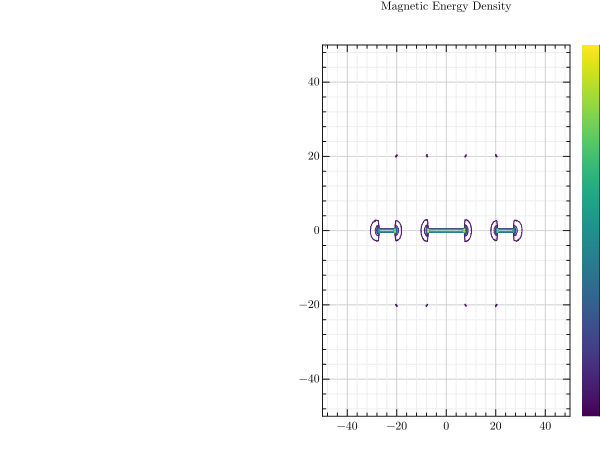

In [21]:
p4 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy Density")

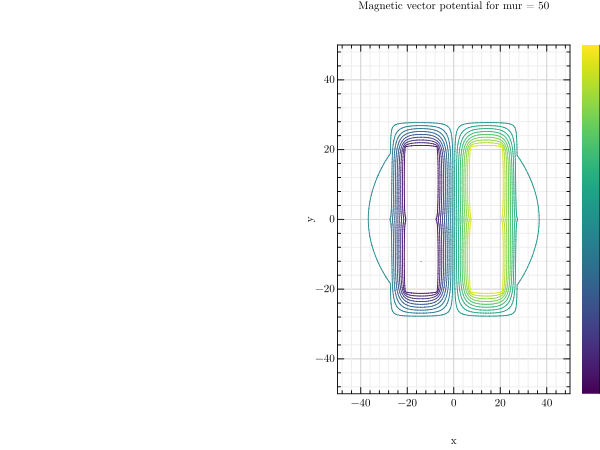

In [22]:
tricont(xnode,ynode,u,xlabel = "x", ylabel = "y",title = "Magnetic vector potential for mur = 50")

Potential is quite outside as compared to the higher relative permeability and so the air becames less affected by to field and potential. 
The energy id concentrated in the air gap but not that concentrated as compared to the mur = 2000 and we can see it being going outwards of the gap.

## Assignment 4

Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor-normal.msh'...
Info    : 75 entities
Info    : 5887 nodes
Info    : 11648 elements
Info    : Done reading 'data/inductor-normal.msh'
Info    : Reading 'data/inductor-normal.msh'...
Info    : 75 entities
Info    : 5887 nodes
Info    : 11648 elements
Info    : Done reading 'data/inductor-normal.msh'


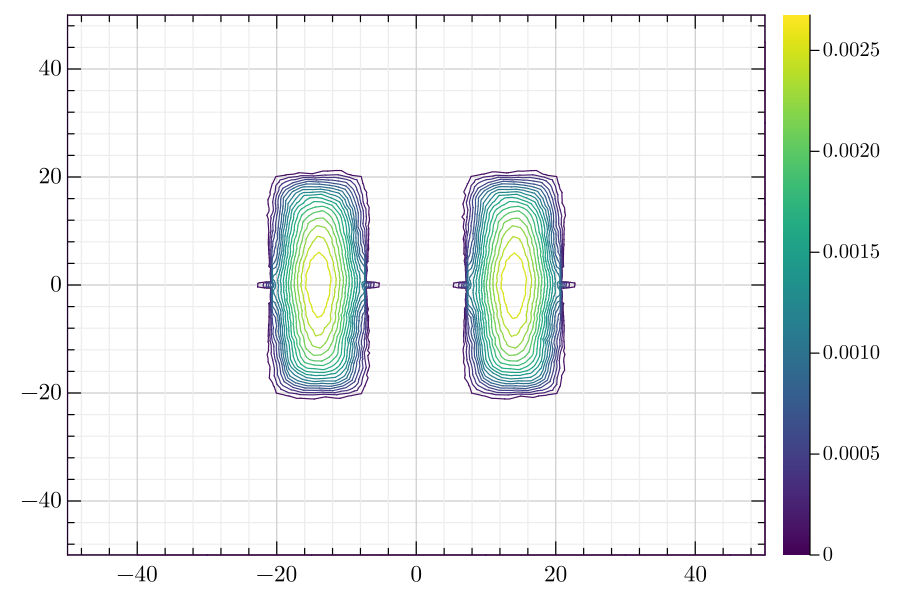

In [23]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

sigma = 1000;
omega = 2*pi*50;

sigmaf(group_id) = 0*((group_id ==1)+(group_id == 4) + (group_id == 5)) + sigma*((group_id ==2)+(group_id == 3))


#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)
    sigmaperelement = map(sigmaf, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], sigmaperelement[element_id], sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc 
        Mvalues[irng]  = Mloc
    end
    
    A = sparse(I,J,Avalues)
    M = sparse(I,J,Mvalues)
    A = A+im*omega*M
   
    return A; 
end



function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor.msh"); A1 = genStiffMat(mesh); f = genVector(mesh); M = genMassMat(mesh);
A=A1+im*omega*M
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor-coarse.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-coarse.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = abs.(u[e1]); uloc2 = abs.(u[e2]); uloc3 = abs.(u[e3]); 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  reluctivityperelement = element.physics.reluctivity
  Hx = reluctivityperelement * Bx 
  Hy = reluctivityperelement * By
  normB2 = sqrt(Bx.^2 + By.^2)
  normH2 = sqrt(Hx.^2 + Hy.^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * reluctivityperelement * normB2
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u)
      end 
      
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density

# Plotting magnetic field components and energy density
GR.tricont(xnode,ynode,abs.(u))




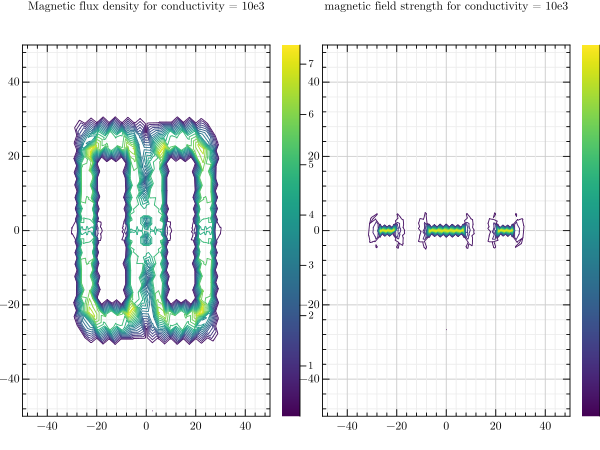

In [3]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic flux density for conductivity = 10e3")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="magnetic field strength for conductivity = 10e3")

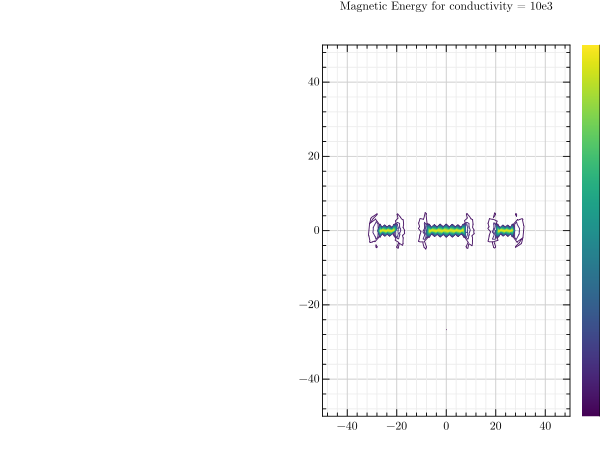

In [4]:
p1 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy for conductivity = 10e3")

Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
  0.000374 seconds (21 allocations: 652.859 KiB)
  0.091328 seconds (34.55 k allocations: 3.953 MiB, 7.25% gc time, 94.53% compilation time)


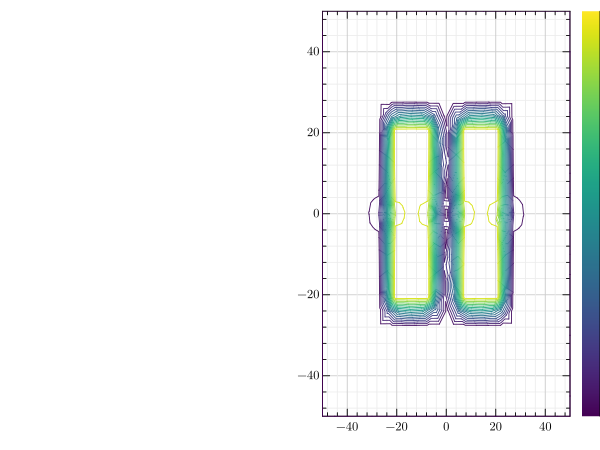

In [12]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4;

sigma = 1e3;
w = 2*pi*50;

conductivityfunction(group_id) = 0*((group_id==1)+(group_id==4)+(group_id==5))+ sigma*((group_id==2)+(group_id==3))
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

sigma = 1e3;
omega = 2*pi*50;

sigmaf(group_id) = 0*((group_id ==1)+(group_id == 4) + (group_id == 5)) + sigma*((group_id ==2)+(group_id == 3))


#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)
    sigmaperelement = map(sigmaf, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], sigmaperelement[element_id], sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor-coarse.msh"); A1 = genStiffMat(mesh); f = genVector(mesh); M = genMassMat(mesh);
A = A1 + 1im*omega*M
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor-coarse.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-coarse.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = abs.(u[e1]); uloc2 = abs.(u[e2]); uloc3 = abs.(u[e3]); 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  reluctivityperelement = element.physics.reluctivity
  Hx = reluctivityperelement * Bx 
  Hy = reluctivityperelement * By
  normB2 = sqrt(Bx.^2 + By.^2)
  normH2 = sqrt(Hx.^2 + Hy.^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * reluctivityperelement * normB2
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u)
      end 
      
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)


GR.tricont(xnode,ynode,abs.(u))



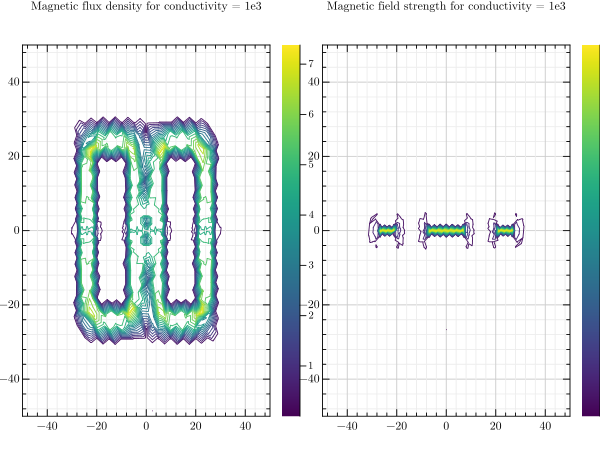

In [13]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic flux density for conductivity = 1e3")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="Magnetic field strength for conductivity = 1e3")

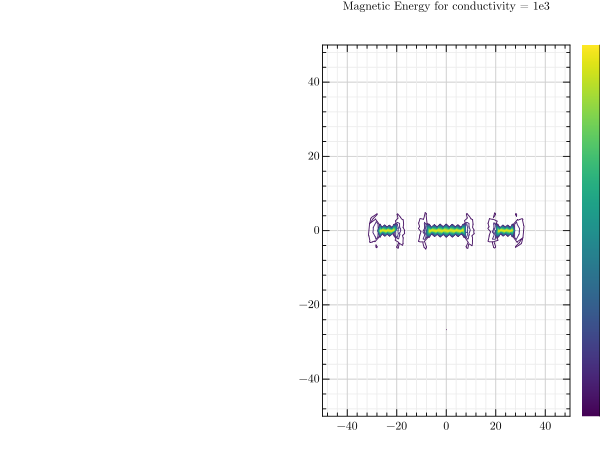

In [14]:
p1 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy for conductivity = 1e3")

I have added the conductivity as well as the frequency and made the relevant changes to the A matrix which is mentioned in the code but there is no difference. This has also been verified by COMSOL Simulation.

## Assignment 5

Info    : Reading 'data/inductor_1.msh'...
Info    : 75 entities
Info    : 8013 nodes
Info    : 15732 elements
Info    : Done reading 'data/inductor_1.msh'
Info    : Reading 'data/inductor_1.msh'...
Info    : 75 entities
Info    : 8013 nodes
Info    : 15732 elements
Info    : Done reading 'data/inductor_1.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
  0.004172 seconds (24 allocations: 6.433 MiB)
  0.062281 seconds (1.22 k allocations: 17.776 MiB, 8.20% compilation time)


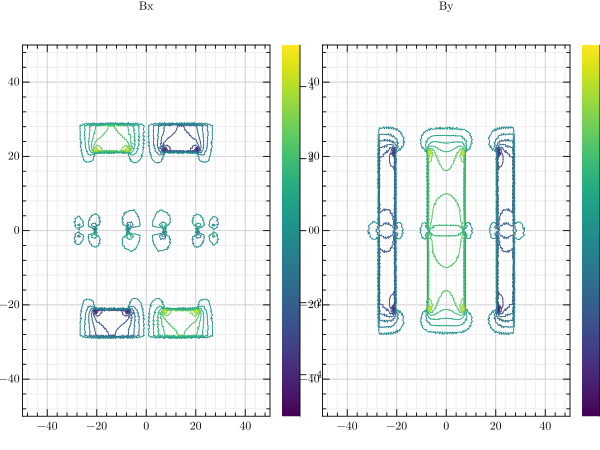

In [29]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end


function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor_1.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor_1.msh");  
xnode,ynode = nodesFromGmsh("data/inductor.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")




Info    : Reading 'data/inductor_2.msh'...
Info    : 75 entities
Info    : 5532 nodes
Info    : 10774 elements
Info    : Done reading 'data/inductor_2.msh'
Info    : Reading 'data/inductor_2.msh'...
Info    : 75 entities
Info    : 5532 nodes
Info    : 10774 elements
Info    : Done reading 'data/inductor_2.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
  0.002917 seconds (24 allocations: 4.409 MiB)
  0.053438 seconds (1.22 k allocations: 10.768 MiB, 12.90% compilation time)


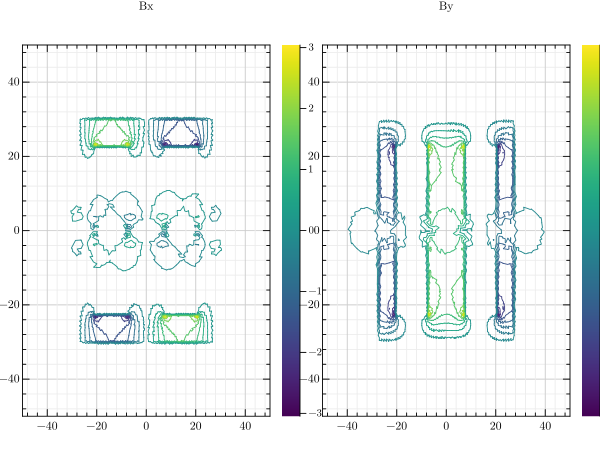

In [30]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end


function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor_2.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor_2.msh");  
xnode,ynode = nodesFromGmsh("data/inductor.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")


As the air gap gets wider, the potential lines spread out significantly, leading to substantial fringing. This happens because a wider air gap increases the reluctance, making it harder for the flux lines to pass through directly. As a result, the flux lines seek paths with lower reluctance. For the widest air gap measured at 5 mm, the potential lines begin to extend into the coil area due to these extensive fringing paths.








## Assignment 6

In [ ]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][6*(element_id-1)+1]
        node2_id = element_connectivity[1][6*(element_id-1)+2]
        node3_id = element_connectivity[1][6*(element_id-1)+3]
        node4_id = element_connectivity[1][6*(element_id-1)+4]
        node5_id = element_connectivity[1][6*(element_id-1)+5]
        node6_id = element_connectivity[1][6*(element_id-1)+6]
        
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 6
           e_group[element_id] = 1;
        elseif G2 == 6 || G3 == 6
           e_group[element_id] = 2;
        elseif G4 == 6
           e_group[element_id] = 4;
        elseif G5 == 6
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][6*(element_id-1)+1]
        e2 = element_connectivity[1][6*(element_id-1)+2]
        e3 = element_connectivity[1][6*(element_id-1)+3]
        e4 = element_connectivity[1][6*(element_id-1)+4]
        e5 = element_connectivity[1][6*(element_id-1)+5]
        e6 = element_connectivity[1][6*(element_id-1)+6]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        p4 = Point(sorted[e4,2], sorted[e4,3])
        p5 = Point(sorted[e5,2], sorted[e5,3])
        p6 = Point(sorted[e6,2], sorted[e6,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,p4,p5,p6,e1,e2,e3,e4,e5,e6,e7,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 36 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e,e1,e1,e1, e2, e2, e2,e2,e2,e2, e3, e3, e3,e3,e3,e3,e4,e4,e4,e4,e4,e4,e5,e5,e5,e5,e5,e5,e6,e6,e6,e6,e6,e6)
    Jloc = SVector(e1, e2, e3,e4,e5,e6,e1, e2, e3,e4,e5,e6,e1, e2, e3,e4,e5,e6,e1, e2, e3,e4,e5,e6,e1, e2, e3,e4,e5,e6,e1, e2, e3,e4,e5,e6)
    Xmat = SMatrix{6,6}(p1.x, p2.x, p3.x,p4.x,p5.x,p6.x, p1.y, p2.y, p3.y,p4.y,p5.y,p6.y, 1, 1, 1,1,1,1) 
    rhs  = SMatrix{6,6}(1., 0., 0.,0., 0., 0.,0., 1., 0.,0., 0., 0.,0., 0., 1.,0., 0., 0.,0., 0., 0.,1., 0., 0.,0., 0., 0.,0., 1., 0.,0., 0., 0.,0., 0., 1.) 
    Emat = MMatrix{6,6}(Xmat\rhs);
    Emat[6,:] .= 0.;  
    Amat = SMatrix{6,6}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:]; Amat[4,:]; Amat[5,:]; Amat[6,:]] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor-coarse.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor-coarse.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-coarse.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")




This code is quite monotonous but I understand how to write the code. All the elements will be 6 because 6 points in an element is considered. Secondly the Aloc matrix will be 6x6. The shape function will be $ax^2 + bx^2 + cxy + dx + ey + f$. After all this changes the code must be executed accordingly.

## Assignment 7

In [31]:
function calculate_reluctivity(B, B_sat, a, H_0)
    # Ensure that B is not greater than B_sat, as the function might not be accurate beyond this point
    B = min(B, B_sat)

    H_guess = B / (mu0 * 2000)  # A guess based on the permeability of vacuum and a factor for steel
    
    # Numerical iteration parameters
    tolerance = 1e-6
    max_iterations = 1000
    iteration = 0
    H = H_guess

    while iteration < max_iterations
        B_calculated = B_sat / (1 + exp(-a * (H - H_0)))
        error = B_calculated - B

        # Check if the calculated B is close enough to the actual B
        if abs(error) < tolerance
            break
        end
        
        # Update H_guess using a simple Newton-Raphson step or other numerical method
        # This is a placeholder for the actual update step:
        # H = update_H_guess(H, error, ...)
        
        # For demonstration, we'll use a simple proportional control:
        H -= error * a  # Adjust 'a' if necessary based on the responsiveness of your B-H curve

        iteration += 1
    end

    # Once we have H, we can calculate reluctivity
    reluctivity = H / B
    return reluctivity
end

# Example parameters for general steel (these would need to be defined based on actual material properties)
B_sat = 1.6  # T
a = 0.003    # Adjust this based on the shape of your B-H curve
H_0 = 800    # A/m

# Example usage
B = 1.2  # T
reluctivity = calculate_reluctivity(B, B_sat, a, H_0)
println("Reluctivity of steel at B=$B T is $reluctivity H/m")


Reluctivity of steel at B=1.2 T is 399.7832005611226 H/m


Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
  0.008283 seconds (24 allocations: 11.586 MiB)
  2.365510 seconds (3.76 M allocations: 285.820 MiB, 17.91% gc time, 95.24% compilation time)


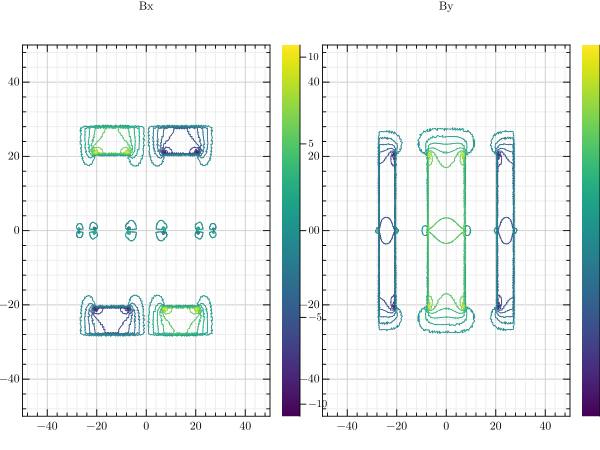

In [2]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end



# Example parameters for general steel (these would need to be defined based on actual material properties)
B_sat = 1.6  # T
a = 0.003    # Adjust this based on the shape of your B-H curve
H_0 = 800    # A/m

mu_min = 2 
mu_max = 2000 
C = 90 


# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end


function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor.msh");  
xnode,ynode = nodesFromGmsh("data/inductor.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")

In [35]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic flux density for conductivity = 1e3")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="Magnetic field strength for conductivity = 1e3")

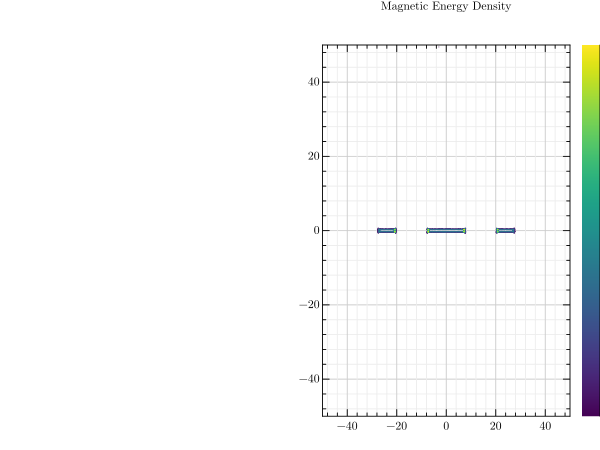

In [36]:
p4 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy Density")

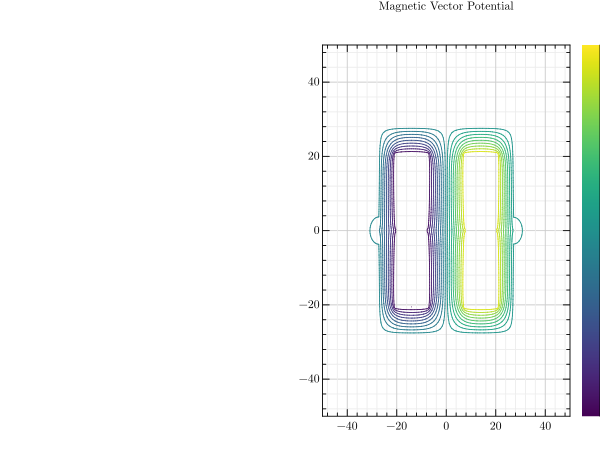

In [3]:
tricont(xnode,ynode,u,title = "Magnetic Vector Potential")

The magnetic flux spreads more into the core and less through the air-gap. Additionally, there's more flux at the edges, and you can see increased fringing effects. This happens because of the non-linear properties of the materials used.

## Assignment 8

Info    : Reading 'data/square-1.msh'...
Info    : 9 entities
Info    : 5 nodes
Info    : 12 elements
Info    : Done reading 'data/square-1.msh'
Info    : Reading 'data/square.msh'...
Info    : 9 entities
Info    : 3013 nodes
Info    : 6028 elements
Info    : Done reading 'data/square.msh'
Info    : Reading 'data/square-1.msh'...
Info    : 9 entities
Info    : 5 nodes
Info    : 12 elements
Info    : Done reading 'data/square-1.msh'
Info    : Reading 'data/square-1.msh'...
Info    : 9 entities
Info    : 5 nodes
Info    : 12 elements
Info    : Done reading 'data/square-1.msh'
  0.000007 seconds (13 allocations: 2.625 KiB)
Info    : Reading 'data/square-1.msh'...
Info    : 9 entities
Info    : 5 nodes
Info    : 12 elements
Info    : Done reading 'data/square-1.msh'
  0.000009 seconds (13 allocations: 2.625 KiB)
Info    : Reading 'data/square-10.msh'...
Info    : 9 entities
Info    : 142 nodes
Info    : 286 elements
Info    : Done reading 'data/square-10.msh'
  0.000059 seconds (18 allocat

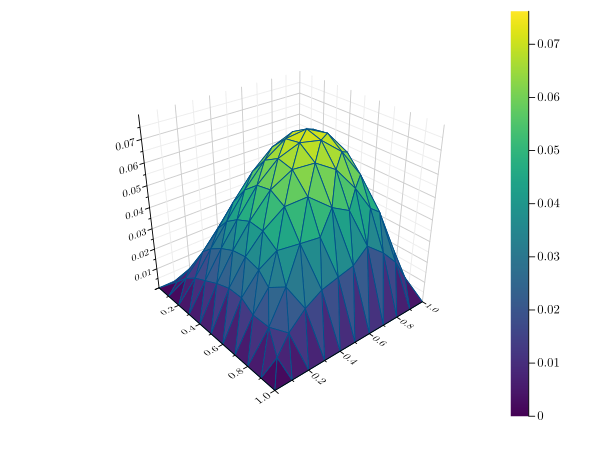

In [3]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to hold a single mesh element
# compared to 4-lab-session, we extend a line segment to a triangle 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64
  e2::Int64
  e3::Int64
  area::Float64  
end

# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end

# compute the area of the triangle with vertices p1, p2 and p3
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# define test data used later in this notebook 
testArea = 0.5
testp1   = Point(0.,0.); 
testp2   = Point(1.,0.); 
testp3   = Point(0.,1.);
testElem = Element(testp1, testp2, testp3, 1, 2, 3, testArea)
testAloc = testArea * [2., -1., -1., -1., 1., 0., -1., 0., 1.]
testMloc = testArea/3 * [1., 0., 0., 0., 1., 0., 0., 0., 2.]
testAcoarse = sparse([1. 0. 0. 0. -1; 0. 1. 0. 0. -1.; 0. 0. 1. 0. -1.; 0. 0. 0. 1. -1.; -1. -1. -1. -1. 4.])
testMcoarse = testArea/3 * [1. 0. 0. 0. 0.; 0. 1. 0. 0. 0.; 0. 0. 1. 0. 0.; 0. 0. 0. 1. 0.; 0. 0. 0. 0. 2.];

@test area_triangle(testp1,testp2,testp3) == testArea
# @code_warntype area_triangle(p1,p2,p3)

# read elements from mesh file 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])
      
    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,1)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,2)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,3)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,4)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

mesh = meshFromGmsh("data/square-1.msh")
xnode, ynode = nodesFromGmsh("data/square.msh")

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end

Iloc, Jloc, Aloc = genLocStiffMat(testElem)
@test Aloc == testAloc

mesh = meshFromGmsh("data/square-1.msh");
A = genStiffMat(mesh)
@test A == testAcoarse

mesh = meshFromGmsh("data/square-1.msh");   @time genStiffMat(mesh); # <= force recompilation 
mesh = meshFromGmsh("data/square-1.msh");   @time genStiffMat(mesh); 
mesh = meshFromGmsh("data/square-10.msh");  @time genStiffMat(mesh); 
mesh = meshFromGmsh("data/square-100.msh"); @time genStiffMat(mesh); 

function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area/3, 0., 0., 0., area/3, 0., 0., 0., area/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end

Iloc, Jloc, Mloc = genLocStiffMat(testElem)
@test Aloc == testAloc

mesh = meshFromGmsh("data/square-1.msh");
M = genMassMat(mesh)
@test M == testMcoarse

mySourceFct(x,y) = x+y 

function genLocVector(element::Element, sourceFct::Function)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    f1 = area/3*sourceFct(p1.x,p1.y)
    f2 = area/3*sourceFct(p2.x,p2.y)
    f3 = area/3*sourceFct(p3.x,p3.y)
    floc = SVector(f1, f2, f3) 
    return Iloc, floc
end

function genVector(mesh, sourceFct::F) where F 
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element,sourceFct)
        f[Iloc] += floc 
    end
       
    return f; 
end

mesh = meshFromGmsh("data/square-1.msh");   @time genVector(mesh,mySourceFct); # <= force recompilation
mesh = meshFromGmsh("data/square-1.msh");   @time genVector(mesh,mySourceFct); 
mesh = meshFromGmsh("data/square-10.msh");  @time genVector(mesh,mySourceFct); 
mesh = meshFromGmsh("data/square-100.msh"); @time genVector(mesh,mySourceFct); 

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

mesh = meshFromGmsh("data/square-10.msh"); A = genStiffMat(mesh); f = genVector(mesh,mySourceFct);
A,f = handleBoundary!(mesh,A,f);

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/square-10.msh");   
A = genStiffMat(mesh); f= genVector(mesh,mySourceFct); # <= force recompilation
@time genSolution!(mesh,A,f);

mesh = meshFromGmsh("data/square-10.msh");  
xnode,ynode = nodesFromGmsh("data/square-10.msh")
@time A = genStiffMat(mesh); f= genVector(mesh,mySourceFct); 
@time u = genSolution!(mesh,A,f)
GR.trisurf(xnode,ynode,u)



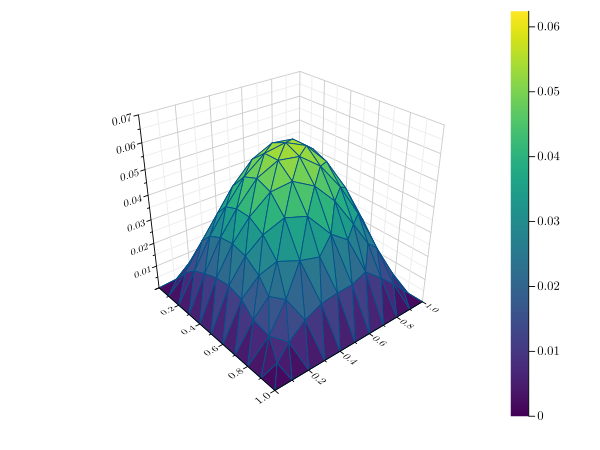

In [4]:
u_f(x,y) = y*(x-1)*x*(y-1);
N = 286; #Which is equal to the number of elements mentioned above
x_a = Vector(0:1/N:1);
y_a = Vector(0:1/N:1);
fsol = u_f.(xnode,ynode);
GR.trisurf(xnode,ynode,fsol)


In [6]:
error = abs.(fsol - u)
error_norm = norm(error)

0.10908126959681945

We can see that mesh is getting finer and also it matches the analytical with error being 0.11.

## Assignment 9

Assuming Neodymium Magnet which has Magnetization at 1T

Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
Info    : Reading 'data/inductor-coarse.msh'...
Info    : 75 entities
Info    : 828 nodes
Info    : 1550 elements
Info    : Done reading 'data/inductor-coarse.msh'
  0.000406 seconds (21 allocations: 652.859 KiB)
  0.007620 seconds (1.21 k allocations: 1.714 MiB, 66.99% compilation time)


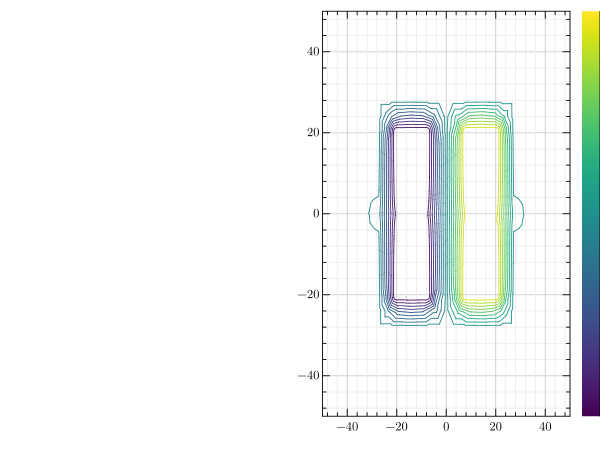

In [12]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
  magnetization::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end

function magnetizationfunction(group_id)
    M0 = 1e6  # Example magnetization strength [A/m]
    return M0 * (group_id == 4) - M0 * (group_id == 5)  # Assuming groups 4 and 5 are where the magnet regions are
end

# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end
#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 
curr_dens_value = 1e4; 
sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 2000; 
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))


# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end

# read elements from mesh file 
# still to be improved for type-stability 
function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group)    
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        magnetization = magnetizationfunction(e_group[element_id])
        physics = Physics(reluctivityperelement[element_id], 1., sourceperelement[element_id],magnetization)
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end

function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
    rhs  = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
    Emat = MMatrix{3,3}(Xmat\rhs);
    Emat[3,:] .= 0.;  
    Amat = SMatrix{3,3}(area*reluctivity*(transpose(Emat)*Emat));
    Aloc = [Amat[1,:] ; Amat[2,:] ; Amat[3,:] ] 
    return Iloc, Jloc, Aloc
end

function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc         
    end
    
    A = sparse(I,J,Avalues)
   
    return A; 
end


function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SMatrix{3,3}(area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3) 
    return Iloc, Jloc, Mloc
end

function genMassMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Mvalues))
    J = zeros(Int64,length(Mvalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Mvalues[irng]    = Mloc         
    end
    
    M = sparse(I,J,Mvalues)
   
    return M; 
end


function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*element.physics.magnetization, area/3*element.physics.magnetization, area/3*element.physics.magnetization) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end

function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end

function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end

mesh = meshFromGmsh("data/inductor-coarse.msh"); A = genStiffMat(mesh); f = genVector(mesh);
A,f = handleBoundary!(mesh,A,f);

mesh = meshFromGmsh("data/inductor-coarse.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-coarse.msh")
@time A = genStiffMat(mesh); f= genVector(mesh); 
@time u = genSolution!(mesh,A,f)

function genDerivLoc(element::Element,u)
  p1 = element.p1; p2 = element.p2; p3 = element.p3;  
  e1 = element.e1; e2 = element.e2; e3 = element.e3;  
  area = element.area 
  uloc1 = u[e1]; uloc2 = u[e2]; uloc3 = u[e3]; 
  Xmat = SMatrix{3,3}(p1.x, p2.x, p3.x, p1.y, p2.y, p3.y, 1, 1, 1) 
  rhs = SMatrix{3,3}(1., 0., 0., 0., 1., 0., 0., 0., 1.) 
  Emat = MMatrix{3,3}(Xmat\rhs);
  Emat[3,:] .= 0.; 
  xmid = (p1.x+p2.x+p3.x)/3
  ymid = (p1.y+p2.y+p3.y)/3
  Bx = uloc1*Emat[2,1]+uloc2*Emat[2,2]+uloc3*Emat[2,3]
  By = uloc1*Emat[1,1]+uloc2*Emat[1,2]+uloc3*Emat[1,3]
  # Permeability (mu_0) is a constant, can be included here or as a separate variable
  reluctivityperelement = element.physics.reluctivity
  Hx = Bx * reluctivityperelement 
  Hy = By * reluctivityperelement 
  normB2 = sqrt(Bx^2 + By^2)
  normH2 = sqrt(Hx^2 + Hy^2)
  # Magnetic energy density
  magEnergyDensity = 0.5 * (Bx*Hx + By*Hy)
  return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

function genDeriv(mesh, u)

    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 

    #..allocate memory for arrays 
    xmid = zeros(nelems,1)
    ymid = zeros(nelems,1)
    Bx = zeros(nelems,1)
    By = zeros(nelems,1)
    normB2 = zeros(nelems,1)
    normH2 = zeros(nelems,1)
    Hx = zeros(nelems,1)
    Hy = zeros(nelems,1)
    magEnergyDensity = zeros(nelems,1)

    for element_id in 1:nelems
        element::Element = mesh.Elements[element_id]
        xmid[element_id], ymid[element_id], Bx[element_id], By[element_id], normB2[element_id], Hx[element_id], Hy[element_id], magEnergyDensity[element_id], normH2[element_id] = genDerivLoc(element,u) 
      end 
  
      return xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2
end

xmid, ymid, Bx, By, normB2, Hx, Hy, magEnergyDensity, normH2 = genDeriv(mesh, u)

# Plotting magnetic field components and energy density
GR.tricont(xnode,ynode,u)




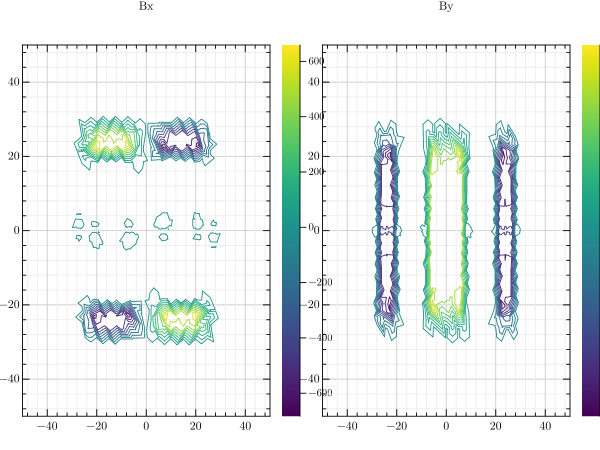

In [13]:
# Plotting magnetic field components and energy density
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,Bx, title="Bx")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,By, title="By")



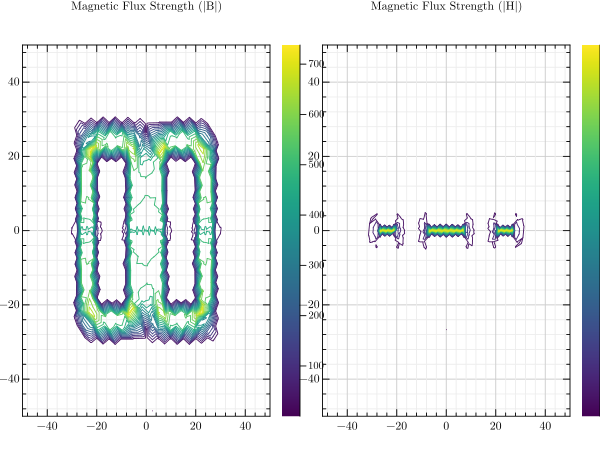

In [14]:
GR.subplot(1,2,1)
p1 = GR.tricont(xmid,ymid,normB2, title="Magnetic Flux Strength (|B|)")
GR.subplot(1,2,2)
p1 = GR.tricont(xmid,ymid,normH2, title="Magnetic Flux Strength (|H|)")

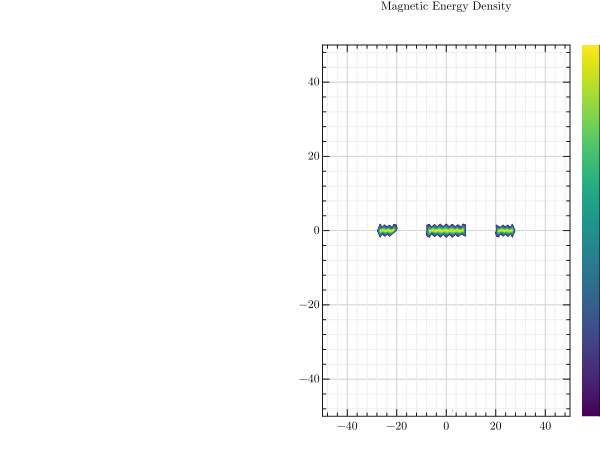

In [15]:
p4 = GR.tricont(xmid,ymid,magEnergyDensity, title="Magnetic Energy Density")

After using the permanent magnet we can see that the magnetic vector potential matches and we get similar flux for the permanent magnet which is considered to have magnetization as 1e6 [A/m] and the current density is not taken into consideration which means it is zero.

Info    : Reading 'data/inductor.msh'...
Info    : 75 entities
Info    : 14326 nodes
Info    : 28358 elements
Info    : Done reading 'data/inductor.msh'
Info    : Reading 'data/inductor-normal.msh'...
Info    : 75 entities
Info    : 5887 nodes
Info    : 11648 elements
Info    : Done reading 'data/inductor-normal.msh'
Info    : Reading 'data/inductor-normal.msh'...
Info    : 75 entities
Info    : 5887 nodes
Info    : 11648 elements
Info    : Done reading 'data/inductor-normal.msh'


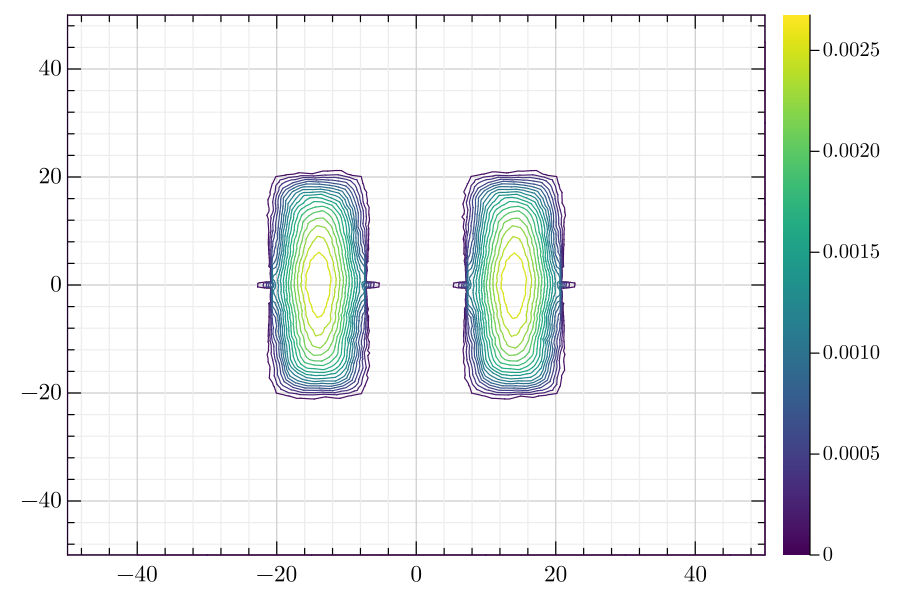

In [13]:
# struct to hold 2D point
struct Point
  x::Float64   # x coordinates
  y::Float64   # y coordinates 
end

# struct to the physics per element 
struct Physics 
  reluctivity::Float64   
  conductivity::Float64  
  currdensity::Float64
end

# struct to hold a single mesh element
# compared to 6-lab-session, we extend with physical properties on the element 
struct Element
  p1::Point       # coordinates first node 
  p2::Point       # coordinates second node 
  p3::Point       # coordinates third node     
  e1::Int64       # global index first node
  e2::Int64       # global index second node
  e3::Int64       # global index third node
  area::Float64   # area of the element 
  physics::Physics 
end

# struct to hold entire mesh
struct Mesh
  nnodes::Int64               # number of nodes 
  nelems::Int64               # number of elements
  Elements::Array{Element,1}  # list of Elements 
  bndNodeIds::Vector{Int64}   # indices of nodes where Dirichlet bc are applied  
  dofPerElem::Int64           # number of dofs per element 
end



#..sets the source on each group of elements of the mesh 
#..sets the current density in the left (positive) and right (negative) side of the winding
#..the current density is zero on the air and coil domain
#..the source is set to be constant on each element in the mesh 

sigma = 10000;
w = 2*pi*50;


curr_dens_value = 1e2;

sourcefunction(group_id) = curr_dens_value*(group_id==4)-curr_dens_value*(group_id==5)

#..sets the reluctivity on each group of elements of the mesh 
#..sets the reluctivity in the ferromagnetic core
#..the reluctivity is set to one on the coil and air domain 
#..the reluctivity is set to be constant on each element in the mesh 
mu0 = 4*pi*1e-7
mur = 1000; 
conductivityfunction(group_id) = 0*((group_id==1)+(group_id==4)+(group_id==5))+ sigma*((group_id==2)+(group_id==3))
reluctivityfunction(group_id) = (1/mu0)*((group_id==1)+(group_id==4)+(group_id==5))+(1/(mu0*mur))*((group_id==2)+mur*(group_id==3))




# compute the area of the triangle with vertices p1, p2 and p3
# same as 6-lab-session 
function area_triangle(p1,p2,p3)    
    x12 = p2.x - p1.x; x13 = p3.x-p1.x;
    y12 = p2.y - p1.y; y13 = p3.y-p1.y;
    area_id = x12*y13 - x13*y12; 
    area_id = abs(area_id)/2.
    return area_id 
end

# group elements in coil, core and air domain 
function groupElements!(e_group,gmshModel)

    #..Get elements from the mesh (more)
    element_types, element_ids, element_connectivity = gmshModel.mesh.getElements(2)
    nelems = length(element_ids[1])
     
    #..Get nodes from physical subdomains (more)
    ngroup1 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 401)
    ngroup2 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 402)
    ngroup3 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 403)
    ngroup4 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 404)
    ngroup5 = gmsh.model.mesh.getNodesForPhysicalGroup(2, 405)

    #..Set group number on each element
    for element_id in 1:nelems
        node1_id = element_connectivity[1][3*(element_id-1)+1]
        node2_id = element_connectivity[1][3*(element_id-1)+2]
        node3_id = element_connectivity[1][3*(element_id-1)+3]
        G1 = sum(node1_id.== ngroup1[1])+sum(node2_id.== ngroup1[1])+sum(node3_id.== ngroup1[1]) #air
        G2 = sum(node1_id.== ngroup2[1])+sum(node2_id.== ngroup2[1])+sum(node3_id.== ngroup2[1]) #upper core
        G3 = sum(node1_id.== ngroup3[1])+sum(node2_id.== ngroup3[1])+sum(node3_id.== ngroup3[1]) #lower core
        G4 = sum(node1_id.== ngroup4[1])+sum(node2_id.== ngroup4[1])+sum(node3_id.== ngroup4[1]) #winding right
        G5 = sum(node1_id.== ngroup5[1])+sum(node2_id.== ngroup5[1])+sum(node3_id.== ngroup5[1]) #winding left
        if G1 == 3
           e_group[element_id] = 1;
        elseif G2 == 3 || G3 == 3
           e_group[element_id] = 2;
        elseif G4 == 3
           e_group[element_id] = 4;
        elseif G5 == 3
           e_group[element_id] = 5;
        end
        
        if (false)
           println("on element ", element_id, " e_group[element_id] = ", e_group[element_id])
        end
     end 
     return e_group 
end



function meshFromGmsh(meshFile)    
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Get the mesh elements
    #..Observe that we get all the two-dimensional triangular elements from the mesh
    element_types, element_ids, element_connectivity = gmsh.model.mesh.getElements(2)
    nelems = length(element_ids[1])

    e_group = zeros(nelems)
    e_group = groupElements!(e_group,gmsh.model)
    reluctivityperelement = map(reluctivityfunction, e_group) 
    conductivityperelement = map(conductivityfunction, e_group)
    sourceperelement = map(sourcefunction, e_group)

    #..Construct uninitialized array of length nelements  
    Elements = Array{Element}(undef,nelems)

    #..Construct the array of elements 
    for element_id in 1:nelems
        e1 = element_connectivity[1][3*(element_id-1)+1]
        e2 = element_connectivity[1][3*(element_id-1)+2]
        e3 = element_connectivity[1][3*(element_id-1)+3]
        p1 = Point(sorted[e1,2], sorted[e1,3])
        p2 = Point(sorted[e2,2], sorted[e2,3])
        p3 = Point(sorted[e3,2], sorted[e3,3])
        area = area_triangle(p1,p2,p3); 
        physics = Physics(reluctivityperelement[element_id], conductivityperelement[element_id], sourceperelement[element_id])
        Elements[element_id] = Element(p1,p2,p3,e1,e2,e3,area,physics)
    end

    #..retrieve boundary nodes by loop over corner point and boundary edges
    node_ids1=[]; node_ids2=[]; node_ids3=[]; node_ids4=[]; 
    node_ids5=[]; node_ids6=[]; node_ids7=[]; node_ids8=[]; 
    node_ids1, node_coord, _ = gmsh.model.mesh.getNodes(0,1)
    node_ids2, node_coord, _ = gmsh.model.mesh.getNodes(0,2)
    node_ids3, node_coord, _ = gmsh.model.mesh.getNodes(0,3)
    node_ids4, node_coord, _ = gmsh.model.mesh.getNodes(0,4)
    node_ids5, node_coord, _ = gmsh.model.mesh.getNodes(1,101)
    node_ids6, node_coord, _ = gmsh.model.mesh.getNodes(1,102)
    node_ids7, node_coord, _ = gmsh.model.mesh.getNodes(1,103)
    node_ids8, node_coord, _ = gmsh.model.mesh.getNodes(1,104)
    bnd_node_ids = union(node_ids1,node_ids2,node_ids3,node_ids4,node_ids5,node_ids6,node_ids7,node_ids8)
    
    #..Set DOF per element
    dofPerElement = 9 
    
    #..Store data inside mesh struct  
    mesh = Mesh(nnodes,nelems,Elements,bnd_node_ids,dofPerElement) 
    
    #..Finalize gmsh
    gmsh.finalize()
    
    return mesh 
end

#..read nodes from mesh file (useful for post-processing)
function nodesFromGmsh(meshFile)
    
    #..Initialize GMSH
    gmsh.initialize()
    
    #..Read mesh from file
    gmsh.open(meshFile)

    #..Get the mesh nodes
    #..Observe that although the mesh is two-dimensional,
    #..the z-coordinate that is equal to zero is stored as well.
    #..Observe that the coordinates are stored contiguously for computational
    #..efficiency
    node_ids, node_coord, _ = gmsh.model.mesh.getNodes()
    nnodes = length(node_ids)
    #..sort the node coordinates by ID, such that Node one sits at row 1
    tosort = [node_ids node_coord[1:3:end] node_coord[2:3:end]];
    sorted = sortslices(tosort , dims = 1);
    node_ids = sorted[:,1]
    xnode = sorted[:,2]
    ynode = sorted[:,3]

    #..Finalize gmsh
    gmsh.finalize()
    
    return xnode,ynode 
end



function genLocStiffMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    reluctivity = element.physics.reluctivity 
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Aloc = SVector((reluctivity,-reluctivity/2.,-reluctivity/2.,-reluctivity/2.,reluctivity/2.,0.,-reluctivity/2.,0.,reluctivity/2.))
    return Iloc, Jloc, Aloc
end



function genLocMassMat(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3;  
    conductivity = element.physics.conductivity
    area = element.area 
    Iloc = SVector(e1, e1, e1, e2, e2, e2, e3, e3, e3)
    Jloc = SVector(e1, e2, e3, e1, e2, e3, e1, e2, e3)
    Mloc = SVector((area*conductivity/3, 0., 0., 0., area*conductivity/3, 0., 0., 0., area*conductivity/3)) 
    return Mloc
end





function genStiffMat(mesh::Mesh)
 
    #..recover number of elements  
    nelems     = mesh.nelems 
    dofPerElem = mesh.dofPerElem;
     
    #..preallocate the memory for local matrix contributions 
    Avalues = zeros(Float64,dofPerElem*nelems)
    Mvalues = zeros(Float64,dofPerElem*nelems)
    I = zeros(Int64,length(Avalues))
    J = zeros(Int64,length(Avalues)) 

    for i = 1:nelems #..loop over number of elements..
        element          = mesh.Elements[i]
        Iloc, Jloc, Aloc = genLocStiffMat(element)
        Mloc = genLocMassMat(element)
        irng             = mrange(dofPerElem*i-8, dofPerElem*i) 
        I[irng]          = Iloc 
        J[irng]          = Jloc 
        Avalues[irng]    = Aloc 
        Mvalues[irng]  = Mloc
    end
    
    A = sparse(I,J,Avalues)
    M = sparse(I,J,Mvalues)
    A = A+im*w*M
   
    return A; 
end



function genLocVector(element::Element)
    p1 = element.p1; p2 = element.p2; p3 = element.p3;  
    e1 = element.e1; e2 = element.e2; e3 = element.e3; 
    currdensity = element.physics.currdensity 
    area = element.area 
    Iloc = SVector(e1, e2, e3) 
    # use broadcast for the lines below instead 
    floc = SVector(area/3*currdensity, area/3*currdensity, area/3*currdensity) 
    return Iloc, floc
end

function genVector(mesh)  
 
    #..recover number of elements  
    nelems  = mesh.nelems 
    nnodes = mesh.nnodes 
     
    #..preallocate the memory for local matrix contributions 
    f = zeros(Float64,nnodes)

    for i = 1:nelems #..loop over number of elements..
        element::Element = mesh.Elements[i]
        Iloc, floc = genLocVector(element)
        f[Iloc] += floc 
    end
       
    return f; 
end





function handleBoundary!(mesh,A,f)
    bndNodeIds = mesh.bndNodeIds; 
    #..handle essential boundary conditions 
    A[bndNodeIds,:] .= 0;
    A[bndNodeIds,bndNodeIds] = Diagonal(ones(size(bndNodeIds)))
    f[bndNodeIds] .= 0;
    return A, f  
end




mesh = meshFromGmsh("data/inductor.msh"); A = genStiffMat(mesh); f = genVector(mesh);

A,f = handleBoundary!(mesh,A,f);



function genSolution!(mesh,A,f)
    A, f = handleBoundary!(mesh,A,f)
    u = A\f 
    return u 
end



mesh = meshFromGmsh("data/inductor-normal.msh");  
xnode,ynode = nodesFromGmsh("data/inductor-normal.msh")
A = genStiffMat(mesh); f= genVector(mesh); 
u = genSolution!(mesh,A,f)
GR.figure(size=(900,600))
GR.tricont(xnode,ynode,abs.(u))



